In [4]:
from __future__ import print_function
from pylab import *

%matplotlib inline

import skimage 
from skimage import img_as_float
from skimage.color import *
from skimage.exposure import * 
from skimage.filters import *

import numpy as np
import imageio
import time

folder_path = 'sekvence/' # root folder za slike

# Prvi zadatak

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


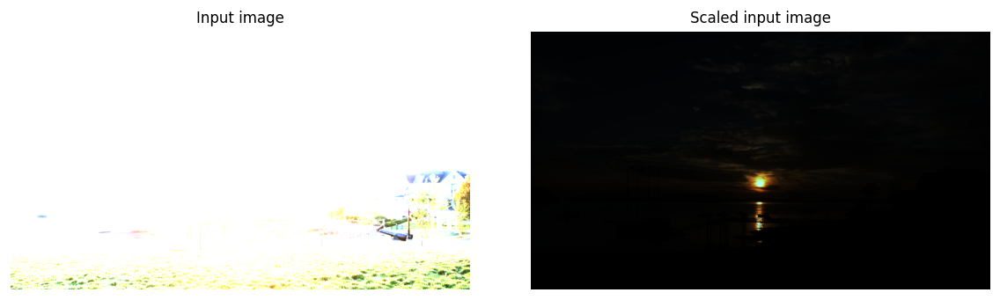

In [8]:
image_name = 'sea.hdr' 
img = imageio.imread(folder_path+image_name, format = 'HDR-FI') # ucitavanje slike 
img_scaled = img/img.flatten().max() # skaliranje slike na opseg od 0 do 1
gamma_factor = 1/2.2 # gama faktor za gama korekciju

#iscrtavanje slike, originalne i preskalirane slike
fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize=(10,12), dpi=120);
ax = axes.ravel()
plt.tight_layout();
ax[0].imshow(img, vmin = 0, vmax = 1, cmap = 'jet'); 
ax[0].set_title('Input image', fontsize=10); 
ax[0].axis('off');

ax[1].imshow(img_scaled, vmin=0, vmax=1, cmap='jet'); 
ax[1].set_title('Scaled input image', fontsize=10); 
ax[1].axis('off');

imageio.plugins.freeimage.download()


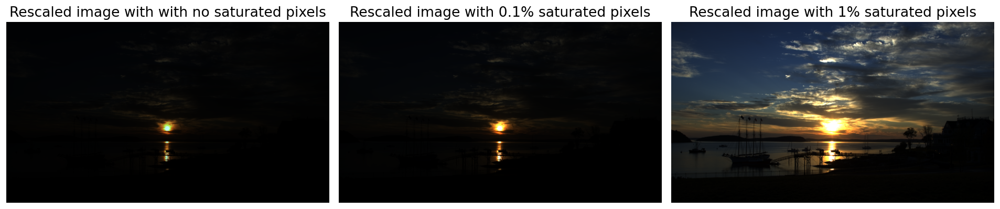

In [9]:
# promena kontrasta slike i preskaliravanje tamnih piksela na svetle
upper_pixels_limit_intensity_0_1=np.percentile(img_scaled.flatten(),99.9) 
img_rescaled_0_1=rescale_intensity(img_scaled, in_range = (0, upper_pixels_limit_intensity_0_1), out_range = (0,1))

upper_pixels_limit_intensity_1=np.percentile(img_scaled.flatten(),99)
img_rescaled_1=rescale_intensity(img_scaled,in_range=(0, upper_pixels_limit_intensity_1), out_range = (0,1))

# iscrtavanje originalne slike,slike sa 0.1% zasicenih piksela i sa 1% zasicenjih piksela
# za dalje procesiranje koristim sliku sa koja je samo skalirana na opseg od 0 do 1
fig,axes=plt.subplots(ncols=3,figsize=(16,8),dpi=120)
ax=axes.ravel()
ax[0].imshow(img_scaled, vmin = 0, vmax = 1);  
ax[0].set_title('Rescaled image with with no saturated pixels',fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_rescaled_0_1, vmin = 0, vmax = 1); 
ax[1].set_title('Rescaled image with 0.1% saturated pixels',fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_rescaled_1, vmin = 1, vmax = 1); 
ax[2].set_title('Rescaled image with 1% saturated pixels',fontsize=16)
ax[2].set_axis_off(); 

plt.tight_layout()
plt.show()

#### a) Linearna transformacija

In [10]:
def linear_transform(img, c, gamma_factor):
    # funkcija za linearnu transformaciju slike, ondosno mnozenje slike sa nekim koeficijentom
    # funkcija vraca transformisanu sliku
    
    
    transformed_img = img*c # mnozenje slike sa zadatim linearnim koeficijentom
    transformed_img[transformed_img > 1] = 1 # saturacija slike, odnosno  svi pikseli koji ispadnu iz opsega od 0 do 1, tj.
    # predju 1, se setuju na najveci moguci intezitet - 1
    transformed_img = transformed_img**gamma_factor # gama korekcija slike sa zadatim gama faktorom
    
    return transformed_img

In [11]:
# linearna transformacija slika 
A = 2
B = 16
C = 41
img_lin_A = linear_transform(img_scaled, A, gamma_factor)
img_lin_B = linear_transform(img_scaled, B, gamma_factor)
img_lin_C = linear_transform(img_scaled, C, gamma_factor)

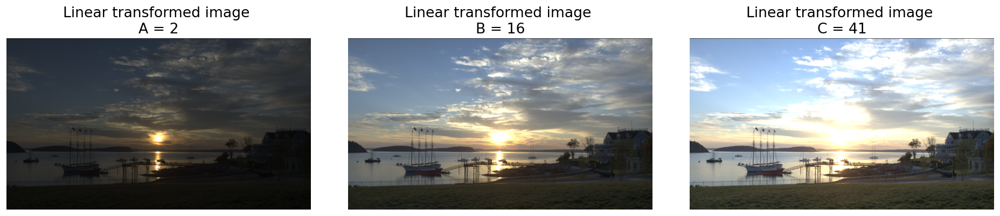

In [12]:
# isrtvanje linearno transformisanih slika za eksperimantalno dobijene koeficijente A, B i C
fig,axes=plt.subplots(nrows=1,ncols=3,figsize=(16,8),dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_lin_A, vmin=0, vmax=1); 
ax[0].set_title('Linear transformed image \nA = ' + str(A), fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_lin_B, vmin=0, vmax=1); 
ax[1].set_title('Linear transformed image \nB = ' + str(B), fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_lin_C, vmin=0, vmax=1);  
ax[2].set_title('Linear transformed image \nC = ' + str(C), fontsize=16)
ax[2].set_axis_off();

plt.show()

#### b) Logaritamska i stepena transformacija

##### Realizacija transformacije slike sa logaritamskom funkcijom

In [13]:
def log_transform(img, c, gamma_factor):
    # funkcija koja radi logaritamsku transformaciju nad slikom,
    # izraz je modifikovan da vrednosti paramentra c ne bi bile ogromne
    # funkcija vraca transformisanu sliku
    
    log_img = log(1+(10**c)*img)/log(1+10**c) 
    log_img[log_img>1] = 1 # saturacija slike, odnosno  svi pikseli koji ispadnu iz opsega od 0 do 1, tj.
    # predju 1, se setuju na najveci moguci intezitet - 1
    log_img = log_img**gamma_factor # gama korekcija slike sa zadatim gama faktorom
    
    return log_img

In [14]:
# logaritamska transformacija nad ulaznom slikom za 4 parametra
log_c1 = 5
log_c2 = 4
log_c3 = 3
log_c4 = 2
img_log_1 = log_transform(img_scaled, log_c1, gamma_factor)
img_log_2 = log_transform(img_scaled, log_c2, gamma_factor)
img_log_3 = log_transform(img_scaled, log_c3, gamma_factor)
img_log_4 = log_transform(img_scaled, log_c4, gamma_factor)

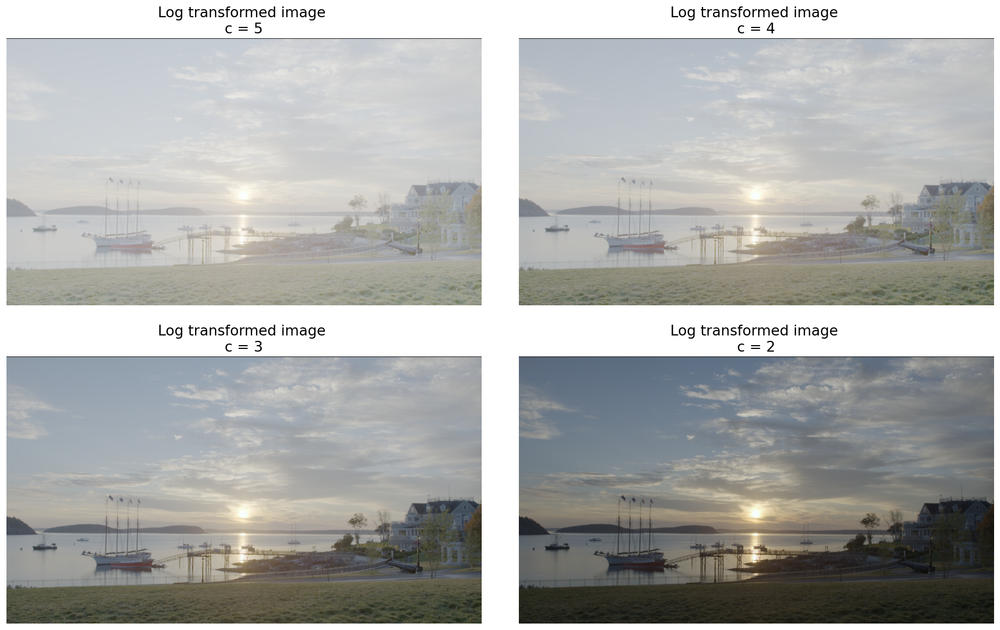

In [15]:
# iscrtavanja slika dobijenih logaritamskom funkcijom za 4 razlicita parametra
fig,axes = plt.subplots(nrows=2, ncols=2, figsize = (16,10), dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_log_1, vmin=0, vmax=1); 
ax[0].set_title('Log transformed image \nc = ' + str(log_c1), fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_log_2, vmin=0, vmax=1); 
ax[1].set_title('Log transformed image \nc = ' + str(log_c2), fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_log_3, vmin=0, vmax=1);  
ax[2].set_title('Log transformed image \nc = ' + str(log_c3), fontsize=16)
ax[2].set_axis_off();

ax[3].imshow(img_log_4, vmin=0, vmax=1);  
ax[3].set_title('Log transformed image \nc = ' + str(log_c4), fontsize=16)
ax[3].set_axis_off();

plt.show()

##### Realizacija transformacije slike sa stepenom funkcijom

In [16]:
def graded_transform(img, c, gamma, gamma_factor): 
    # funkcija za stepenu transofrmaciju slike sa zadatim parametrima c i gamma
    # funkcija vraca transformisanu sliku
    
    graded_img = c*img**gamma
    graded_img[graded_img>1] = 1 # saturacija piksela
    graded_img = graded_img**gamma_factor # gama korekcija
    
    return graded_img

In [17]:
# stepena transfomracija slike za 4 paramentra
grad_c1 = 2
grad_c2 = 3
grad_c3 = 4
grad_c4 = 5
grad_gamma1 = 0.8
grad_gamma2 = 0.7
grad_gamma3 = 0.6
grad_gamma4 = 0.5

img_grad_1 = graded_transform(img_scaled, grad_c1, grad_gamma1, gamma_factor)
img_grad_2 = graded_transform(img_scaled, grad_c2, grad_gamma2, gamma_factor)
img_grad_3 = graded_transform(img_scaled, grad_c3, grad_gamma3, gamma_factor)
img_grad_4 = graded_transform(img_scaled, grad_c4, grad_gamma4, gamma_factor)

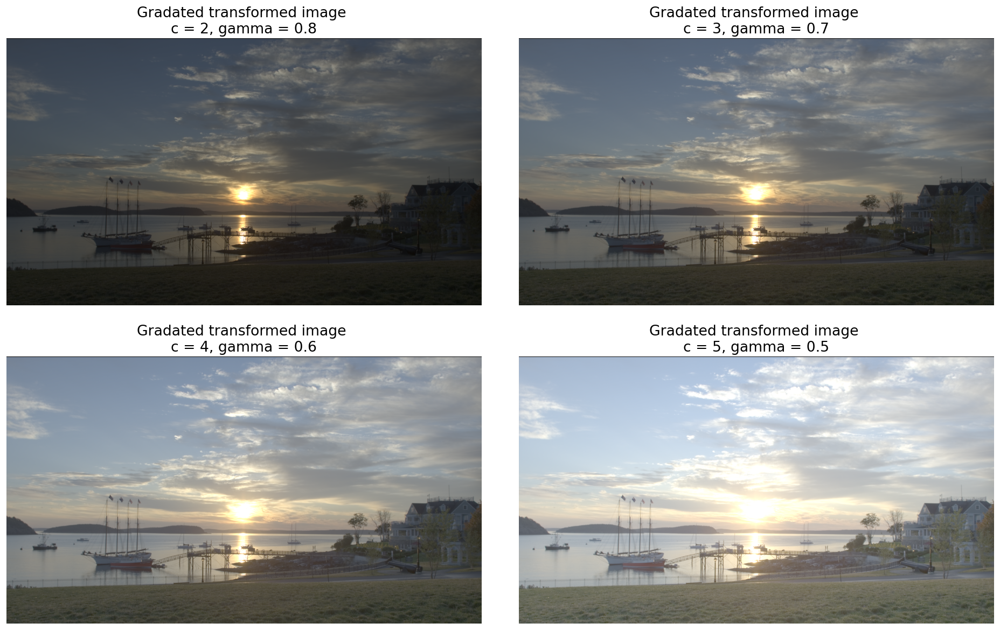

In [18]:
# iscrtavanje slika dobijenih stepenom transformacijom za 4 ulazna parametra
fig,axes = plt.subplots(nrows=2, ncols=2, figsize = (16,10), dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_grad_1, vmin=0, vmax=1); 
ax[0].set_title('Gradated transformed image \nc = ' + str(grad_c1) + ', gamma = ' + str(grad_gamma1), fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_grad_2, vmin=0, vmax=1); 
ax[1].set_title('Gradated transformed image \nc = ' + str(grad_c2) + ', gamma = ' + str(grad_gamma2), fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_grad_3, vmin=0, vmax=1);  
ax[2].set_title('Gradated transformed image \nc = ' + str(grad_c3) + ', gamma = ' + str(grad_gamma3), fontsize=16)
ax[2].set_axis_off();

ax[3].imshow(img_grad_4, vmin=0, vmax=1);  
ax[3].set_title('Gradated transformed image \nc = ' + str(grad_c4) + ', gamma = ' + str(grad_gamma4), fontsize=16)
ax[3].set_axis_off();

plt.show()

#### c) Ostale funkcije

##### Realizacija transformacije slike sa eksponencijalnom funkcijom

In [19]:
def exp_transform(img, c, gamma_factor): 
    # eksponencijalna transformacija na slikom
    # funkcija je monotono rastuca , pa sluzi da posvetli sliku , sto je slucaj ovde
    # funkcija vraca transfomisanu sliku
    
    exp_img=1-exp(-img/c) # transformacija
    exp_img[exp_img>1] =1 # saturacija piksela
    exp_img = exp_img**gamma_factor # gama korekcija
    
    return exp_img

In [20]:
# eksponencijalna transformacija nad ulaznom slikom 
exp_c1 = 1
exp_c2 = 0.5
exp_c3 = 0.25
exp_c4 = 0.125

img_exp_1 = exp_transform(img_scaled, exp_c1, gamma_factor)
img_exp_2 = exp_transform(img_scaled, exp_c2, gamma_factor)
img_exp_3 = exp_transform(img_scaled, exp_c3, gamma_factor)
img_exp_4 = exp_transform(img_scaled, exp_c4, gamma_factor)

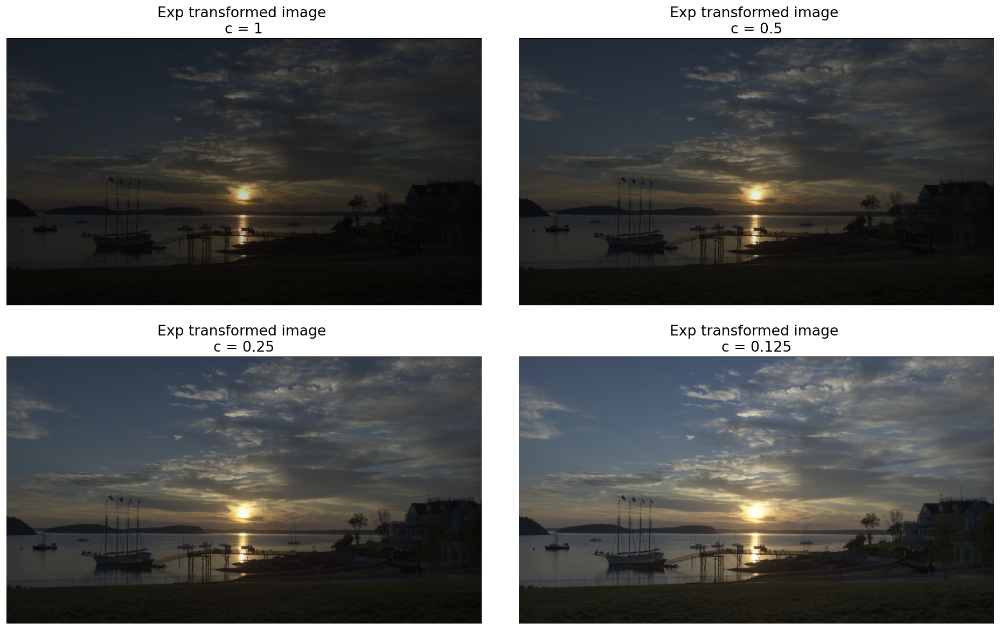

In [21]:
# iscrtavanje slika eksponencijalno transformisanih
fig,axes = plt.subplots(nrows=2, ncols=2, figsize = (16,10), dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_exp_1, vmin=0, vmax=1); 
ax[0].set_title('Exp transformed image \nc = ' + str(exp_c1), fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_exp_2, vmin=0, vmax=1); 
ax[1].set_title('Exp transformed image \nc = ' + str(exp_c2), fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_exp_3, vmin=0, vmax=1);  
ax[2].set_title('Exp transformed image \nc = ' + str(exp_c3), fontsize=16)
ax[2].set_axis_off();

ax[3].imshow(img_exp_4, vmin=0, vmax=1);  
ax[3].set_title('Exp transformed image \nc = ' + str(exp_c4), fontsize=16)
ax[3].set_axis_off();

plt.show()

##### Realizacija transformacije slike sa acrtg funkcijom

In [23]:
def arctan_transform(img, c, gamma_factor):
    # arkus-tangesna funkcija 
    # funkcija je monotono rastuca , pa posvetljuje sliku
    # funkcija vraca transformisanu sliku
    
    arctan_img=2/pi * arctan(img/c)
    arctan_img[arctan_img>1] = 1
    arctan_img = arctan_img**gamma_factor
    
    return arctan_img

In [24]:
# arkus-tangesna transformacija na slikom 
atan_c1 = 0.5
atan_c2 = 0.25
atan_c3 = 0.125
atan_c4 = 0.0625

img_atan_1 = arctan_transform(img_scaled, atan_c1, gamma_factor)
img_atan_2 = arctan_transform(img_scaled, atan_c2, gamma_factor)
img_atan_3 = arctan_transform(img_scaled, atan_c3, gamma_factor)
img_atan_4 = arctan_transform(img_scaled, atan_c4, gamma_factor)

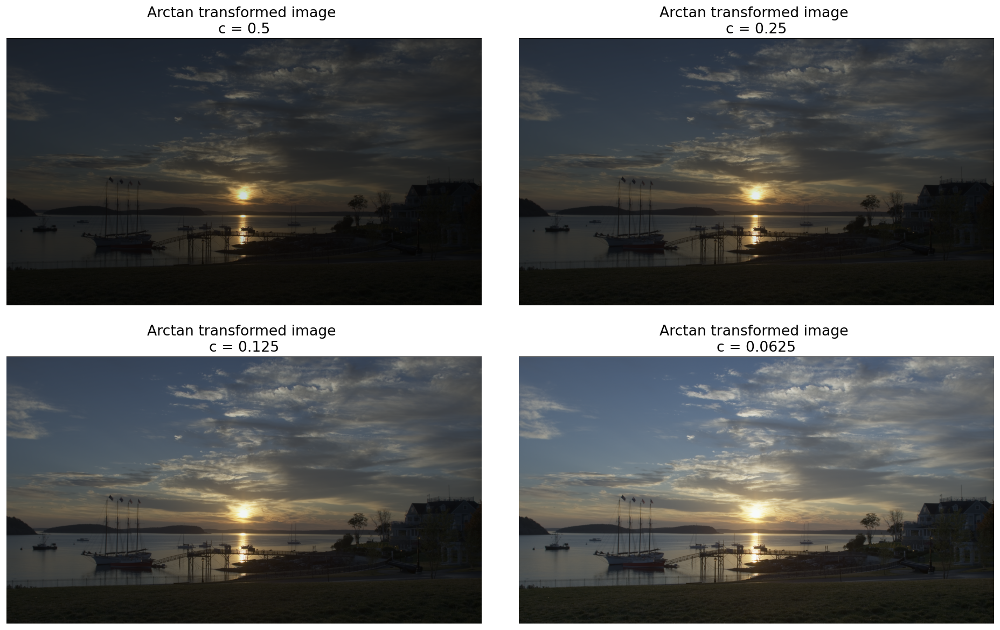

In [25]:
# iscrtavanja slika transformisanih arkus tangesnom funkcijom
fig,axes = plt.subplots(nrows=2, ncols=2, figsize = (16,10), dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_atan_1, vmin=0, vmax=1); 
ax[0].set_title('Arctan transformed image \nc = ' + str(atan_c1), fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_atan_2, vmin=0, vmax=1); 
ax[1].set_title('Arctan transformed image \nc = ' + str(atan_c2), fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_atan_3, vmin=0, vmax=1);  
ax[2].set_title('Arctan transformed image \nc = ' + str(atan_c3), fontsize=16)
ax[2].set_axis_off();

ax[3].imshow(img_atan_4, vmin=0, vmax=1);  
ax[3].set_title('Arctan transformed image \nc = ' + str(atan_c4), fontsize=16)
ax[3].set_axis_off();

plt.show()

##### Realizacija transformacije slike pomocu razvlacenja histograma

In [26]:
def histogram_streching(img, percent, gamma_factor):
    # funkcija za razvlacenje histograma za zadat procenat tamnih piksela 
    # funkcija vraca sliku sa rasirenim histogramom
    
    pixels_max = np.percentile(img.flatten(),percent)
    rescaled_img = rescale_intensity(img_scaled, in_range=(0, pixels_max), out_range = (0,1)) # rescale-ovanje slike  i sirenje histograma
    rescaled_img[rescaled_img >1] = 1
    rescaled_img = rescaled_img**gamma_factor
    
    return rescaled_img

In [27]:
# razvlacenje histograma slike za 4 parametra
percent1 = 95
percent2 = 90
percent3 = 85
percent4 = 80

img_hist_1 = histogram_streching(img_scaled, percent1, gamma_factor)
img_hist_2 = histogram_streching(img_scaled, percent2, gamma_factor)
img_hist_3 = histogram_streching(img_scaled, percent3, gamma_factor)
img_hist_4 = histogram_streching(img_scaled, percent4, gamma_factor)

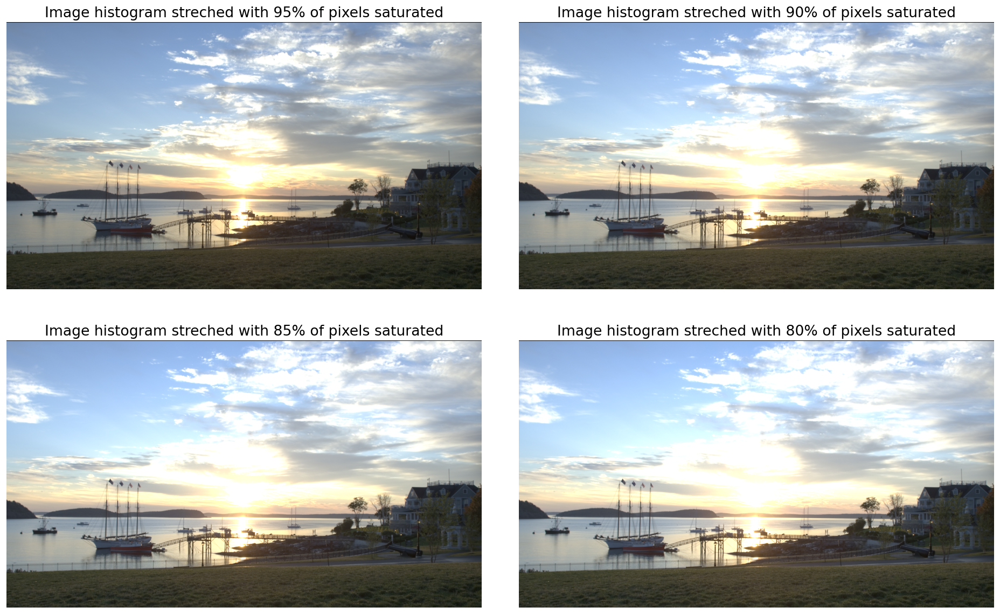

In [28]:
# iscrtavanje slika sa razvucenim histogramom
fig,axes = plt.subplots(nrows=2, ncols=2, figsize = (16,10), dpi=120)
ax=axes.ravel() 
plt.tight_layout()

ax[0].imshow(img_hist_1, vmin=0, vmax=1); 
ax[0].set_title('Image histogram streched with ' + str(percent1) + '% of pixels saturated', fontsize=16)
ax[0].set_axis_off();

ax[1].imshow(img_hist_2, vmin=0, vmax=1); 
ax[1].set_title('Image histogram streched with ' + str(percent2) + '% of pixels saturated', fontsize=16)
ax[1].set_axis_off(); 

ax[2].imshow(img_hist_3, vmin=0, vmax=1);  
ax[2].set_title('Image histogram streched with ' + str(percent3) + '% of pixels saturated', fontsize=16)
ax[2].set_axis_off();

ax[3].imshow(img_hist_4, vmin=0, vmax=1);  
ax[3].set_title('Image histogram streched with ' + str(percent4) + '% of pixels saturated', fontsize=16)
ax[3].set_axis_off();

plt.show()

###### b) Logaritamska i stepena funkcija daju jako dobre rezultate u poboljsanju kontrasta i kvaliteta slike. Logaritamska funkcija daje jako dobar rezultat za c = 2.5 do 1.8 , dok stepena funkcija daje jako dobar rezultat za c = 3 i gama = [0.5 - 0.7]. 
###### c) Predlozio sam 3 metoda za poboljsanje kvaliteta slike, to su dve 'izmisljene' funkcije, to su exp i atan, koje su u datoj formi monotono rastuce, pa fino poboljsavaju kontrast slike. Ta poboljsanja ne mogu biti dovoljno dobra kao kod logaritamske i stepene funkcije, ali je i dalje znacajan. Takodje, dodata je i metoda razvlacenja histograma za poboljsanje kontrasta,kao jedna od standardnih metoda za poboljsanje kvaliteta/kontrasta. 

# Drugi zadatak 

#### Obrada prve zadate slike - marlyn.jpg

Image dimensions : (2520, 2100, 3)
Max image value : 255


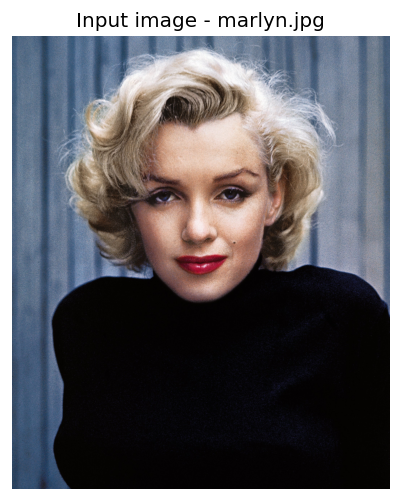

In [29]:
image_name = 'marlyn.jpg'
marlyn_rgb = imread(folder_path+image_name)

# ucitavanje slike i iscrtavanje 
marlyn_dimensions = shape(marlyn_rgb)
print('Image dimensions : ' + str(marlyn_dimensions))
print('Max image value : ' + str(marlyn_rgb.flatten().max()))
 
figure(figsize = (5, 5), dpi = 120);
imshow(marlyn_rgb,  vmin = 0, vmax = 255);
plt.title('Input image - ' + str(image_name))
plt.axis('off')
plt.show();

###### Za realizaciju ovog dela zadatka koristim HSV kolor sistem, jer se vrlo lako moze izdvojiti boja koja je potrebna. 

In [30]:
marlyn_hsv = rgb2hsv(marlyn_rgb) # konverzija slike u hsv kolor sistem

hue = marlyn_hsv[:,:,0] # hue komponenta
sat = marlyn_hsv[:,:,1] # saturation komponenta
val = marlyn_hsv[:,:,2] # value komponenta

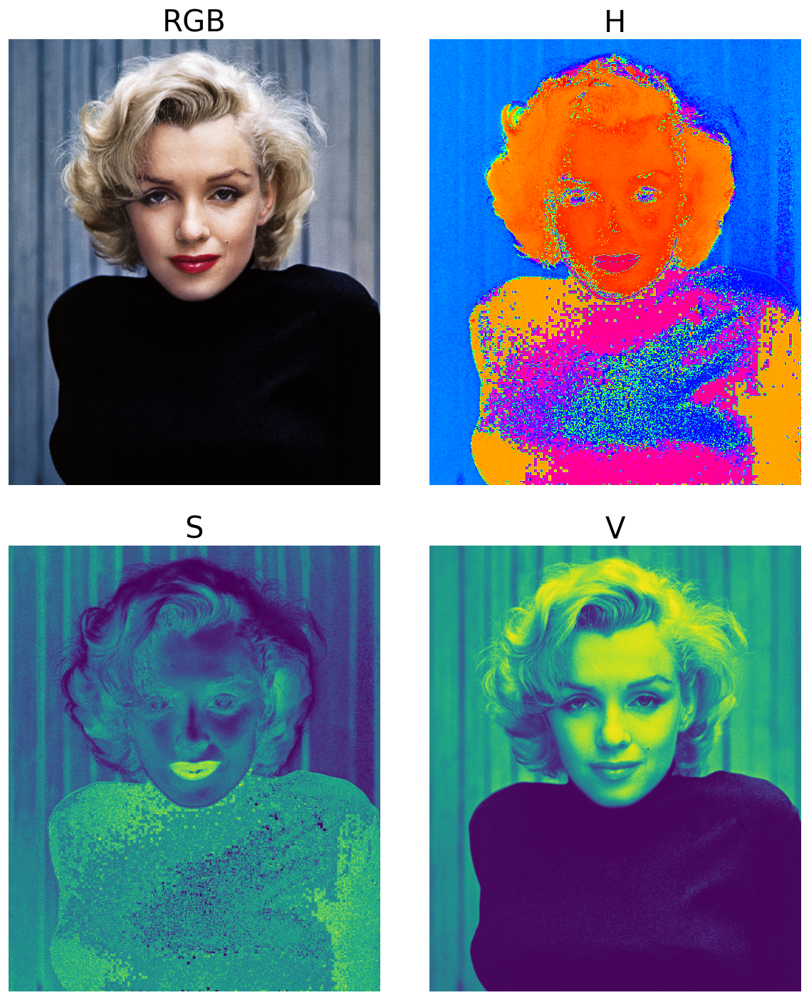

In [31]:
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize=(10,12), dpi=120);
ax = axes.ravel()
plt.tight_layout();
ax[0].imshow(marlyn_rgb, vmin=0, vmax=255, cmap='jet'); 
ax[0].set_title('RGB', fontsize=25); 
ax[0].axis('off');

ax[1].imshow(hue, vmin=0, vmax=1, cmap='hsv'); 
ax[1].set_title('H', fontsize=25);  
ax[1].axis('off');

ax[2].imshow(sat, vmin=0, vmax=1); 
ax[2].set_title('S', fontsize=25); 
ax[2].axis('off');

ax[3].imshow(val, vmin=0, vmax=1); 
ax[3].set_title('V', fontsize=25); 
ax[3].axis('off');
plt.show()
# primetno je da se mogu iskoristite vrednosti H i S za formiranje maske 
# sa H 'dijagrama' vidi da boja koja nam je potrebna jeste neka roze boja, a kako usne nisu roze boje
# potrebno je onda posmatrati i S i V vrednosti
# sa S 'dijagrama' se vidi jako izrazena saturacija u predelu usana, tj. predelu koji treba izdvojiti

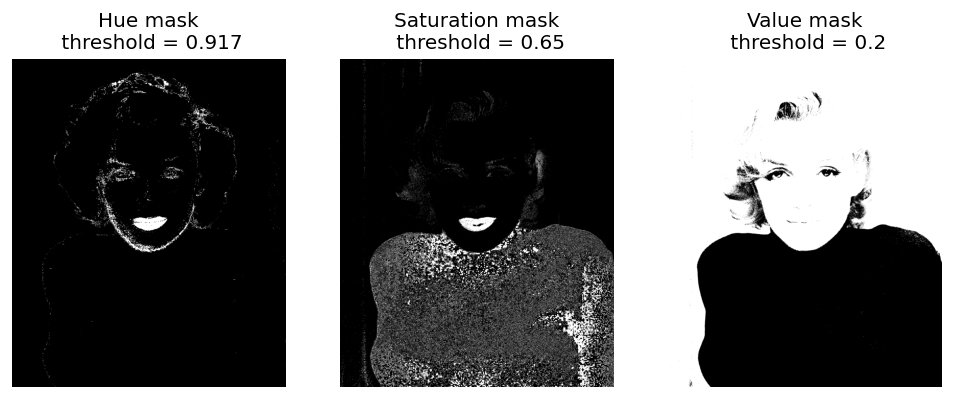

In [32]:
hue_threshold = 330/360 # hue vrednost za roze boju
sat_threshold = 0.65 # eksperimantlno odredjena vrednost za saturation prag
val_threshold = 0.2 # eksperimantlno odredjena vrednost za value prag

hue_mask = hue > hue_threshold # Binarizacija hue maske
sat_mask = sat > sat_threshold # Binarizacija maske saturacije
val_mask = val > val_threshold # Binarizacija maske value

# Iscrtavanje maski
fig, axes = subplots(ncols = 3, nrows = 1, figsize = (10, 10), dpi = 120)
ax = axes.ravel();

ax[0].imshow(hue_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[0].set_title('Hue mask\n threshold = '+str(round(hue_threshold,3))); 
ax[0].axis('off');

ax[1].imshow(sat_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[1].set_title('Saturation mask\n threshold = '+str(sat_threshold)); 
ax[1].axis('off');

ax[2].imshow(val_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[2].set_title('Value mask\n threshold = '+str(val_threshold)); 
ax[2].axis('off');


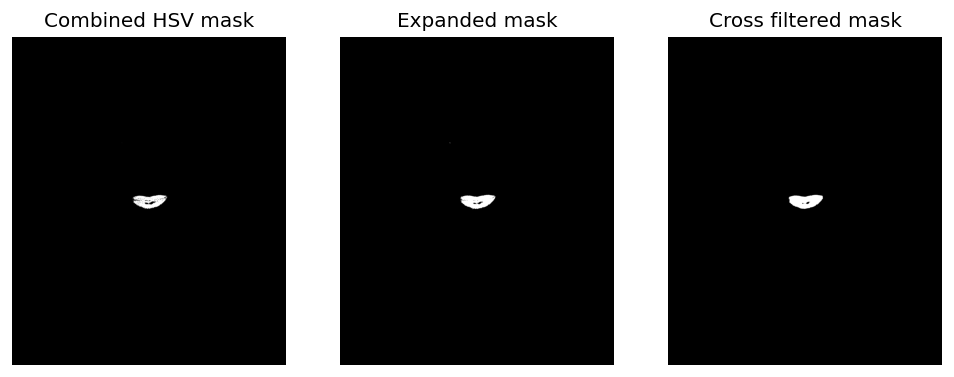

In [33]:
combined_hsv_mask = hue_mask * sat_mask * val_mask # Kombinovanje prethodno definisanih maski

square = np.ones((3,3), dtype=float) # Formiranje prozora za dilataciju
expanded_combined_hsv_mask = skimage.morphology.binary_dilation(combined_hsv_mask, square) # Dilatacija maske

# Formiranje prozora u obliku krsta za median filter
cross = zeros((25,25));
cross[12,:] = 1;
cross[:,12] = 1

cross_filtered_mask = median(expanded_combined_hsv_mask,cross); # Filtriranje median filtrom

# Iscrtavanje kombinovenih maski, maske dobijene dilataijom i maske nakon filtriranja median filtrom u obliku krsta
fig, axes = subplots(ncols = 3, nrows = 1, figsize = (10, 10), dpi = 120)
ax = axes.ravel();

ax[0].imshow(combined_hsv_mask, cmap = 'gray', vmin = 0, vmax = 1); ax[0].set_title('Combined HSV mask'); ax[0].axis('off');
ax[1].imshow(expanded_combined_hsv_mask, cmap = 'gray', vmin = 0, vmax = 1); ax[1].set_title('Expanded mask'); ax[1].axis('off');
ax[2].imshow(cross_filtered_mask, cmap = 'gray', vmin = 0, vmax = 1); ax[2].set_title('Cross filtered mask'); ax[2].axis('off');

final_mask = cross_filtered_mask

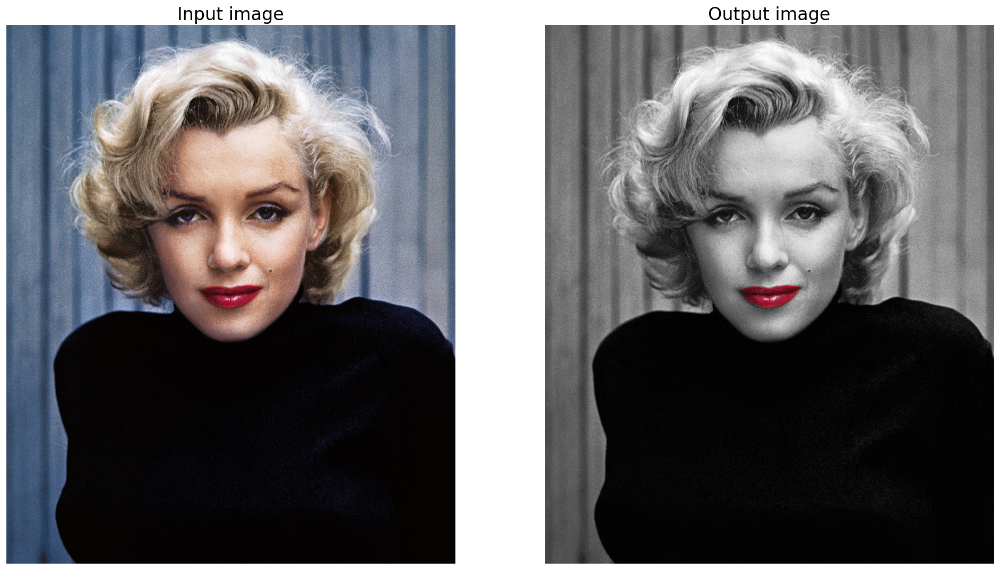

In [34]:
lips_rgb = zeros((shape(marlyn_rgb)), dtype = 'uint8') # Alociranje memorije za masku u boji
no_lips_rgb = zeros((shape(marlyn_rgb)), dtype = 'uint8') # Alociranje memorije za sliku sa crnim delom u regionu usana
for i in range (3):
    lips_rgb[:,:,i] = marlyn_rgb[:,:,i]*final_mask # Izdvajanje RGB komponenti maske usana
    no_lips_rgb[:,:,i] = marlyn_rgb[:,:,i]*(~final_mask) # Izdvajanje rgb komponenti bez usana

marlyn_gray_no_lips = uint8(mean(no_lips_rgb, 2)) # Prebacivanje u sivu sliku bez usana
marlyn_rgb_no_lips = gray2rgb(marlyn_gray_no_lips) # Prebacivanje sive slike u RGB
marlyn_only_lips = marlyn_rgb_no_lips + lips_rgb # Spajanje maske u boji sa sivom slikom

# Iscrtavanje rezultata
fig, axes = subplots(ncols = 2, nrows = 1, figsize = (20, 20), dpi = 120)
ax = axes.ravel();

ax[0].imshow(marlyn_rgb); ax[0].set_title('Input image', fontsize = 20); ax[0].axis('off');
ax[1].imshow(marlyn_only_lips); ax[1].set_title('Output image', fontsize = 20); ax[1].axis('off');

#### Obrada druge zadate slike - street.jpg

Image dimensions : (470, 705, 3)
Max image value : 255


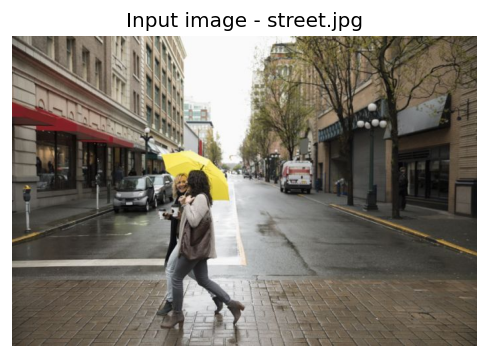

In [35]:
image_name = 'street.jpg'
street_rgb = imread(folder_path+image_name) # Ucitavanje slike

street_dimensions = shape(street_rgb) # Uzimanje dimenzija
print('Image dimensions : ' + str(street_dimensions))
print('Max image value : ' + str(street_rgb.flatten().max()))
 
# Iscrtavanje ucitane slike
figure(figsize = (5, 5), dpi = 120);
imshow(street_rgb,  vmin = 0, vmax = 255);
plt.title('Input image - ' + str(image_name))
plt.axis('off')
plt.show();

In [36]:
street_hsv = rgb2hsv(street_rgb) # Prebacivanje pocetne slike u HSV kolor sistem

# Izdvajanje komponenti HSV kolor sistema
hue = street_hsv[:,:,0]
sat = street_hsv[:,:,1]
val = street_hsv[:,:,2]

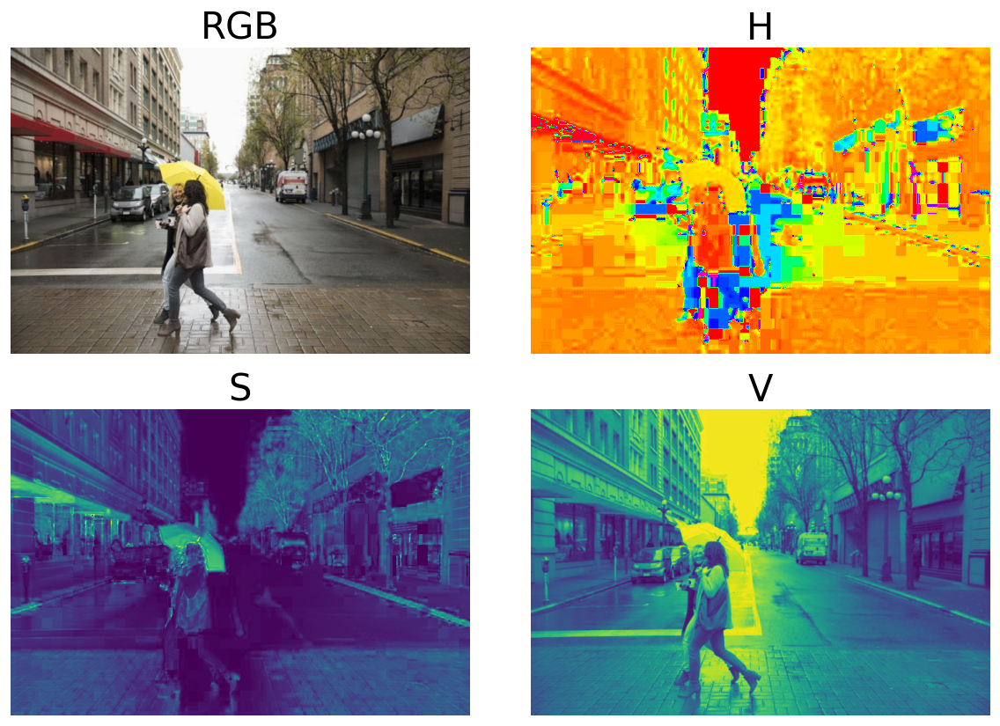

In [37]:
# Iscrtavanje komponenti HSV kolor sistema
fig, axes = plt.subplots(nrows = 2, ncols = 2, figsize=(10,7), dpi=120);
ax = axes.ravel()
plt.tight_layout();
ax[0].imshow(street_rgb, vmin=0, vmax=255, cmap='jet');
ax[0].set_title('RGB', fontsize=25); 
ax[0].axis('off');

ax[1].imshow(hue, vmin=0, vmax=1, cmap='hsv'); 
ax[1].set_title('H', fontsize=25);  
ax[1].axis('off');

ax[2].imshow(sat, vmin=0, vmax=1); 
ax[2].set_title('S', fontsize=25); 
ax[2].axis('off');

ax[3].imshow(val, vmin=0, vmax=1); 
ax[3].set_title('V', fontsize=25); 
ax[3].axis('off');

plt.show()
# primetno je da se mogu iskoristite vrednosti H, S i V za formiranje maske 
# sa H 'dijagrama' vidi da boja koja nam je potrebna jeste neka tamnija zuta boja, a kako na 'H dijagramu' 
# ima jos dosta zute boje, potrebno je iskoristiti i vrednosti  S i V za kreiranje maske

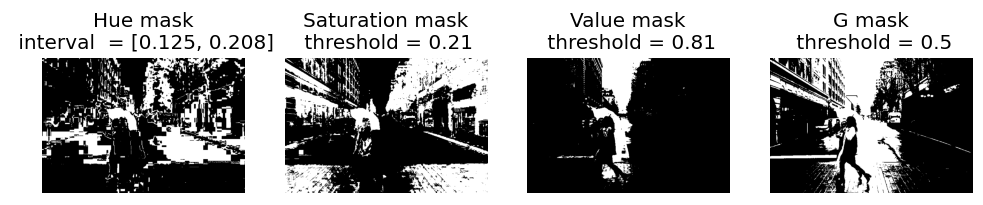

In [38]:
hue_threshold_1 = 45/360 # hue vrednost za tamno zutu boju
hue_threshold_2 = 75/360 # hue vrednost za tamno zutu boju
sat_threshold = 0.21 # Prag binarizacije S komponente
val_threshold = 0.81 # Prag binarizacije V komponente
G_threshold = 0.50 # Prag binarizacije G komponenete

hue_mask = (hue > hue_threshold_1) * (hue < hue_threshold_2) # Binarizacija H komponeente
sat_mask = sat > sat_threshold # Binarizacija S komponente
val_mask = val > val_threshold # Binarizacija V komponente
G_mask = street_rgb[:,:,1]/255 > G_threshold # Binarizacija G komponente
            
# Iscrtavanje dobijenih binarnih maski
fig, axes = subplots(ncols = 4, nrows = 1, figsize = (10, 10), dpi = 120)
ax = axes.ravel();

ax[0].imshow(hue_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[0].set_title('Hue mask\n interval  = ['+str(round(hue_threshold_1, 3)) + ', ' +str(round(hue_threshold_2, 3)) + ']'); 
ax[0].axis('off');

ax[1].imshow(sat_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[1].set_title('Saturation mask\n threshold = '+str(sat_threshold)); 
ax[1].axis('off');

ax[2].imshow(val_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[2].set_title('Value mask\n threshold = '+str(val_threshold)); 
ax[2].axis('off');

ax[3].imshow(G_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[3].set_title('G mask\n threshold = '+str(G_threshold)); 
ax[3].axis('off');


In [39]:
combined_hsv_mask = (val_mask + G_mask) * sat_mask * hue_mask # Kombinovanje prethodno dobijenih binarnih maski

combined_hsv_mask_removed = skimage.morphology.remove_small_objects(combined_hsv_mask, 200) # Uklanjanje malih pixela (outlier-a)

square = np.ones((10,10), dtype=float) # Formiranje prozora za median filtar
median_filtered_mask =  median(combined_hsv_mask_removed, square) # Filtriranje median filtra

final_mask = skimage.morphology.remove_small_objects(median_filtered_mask, 20) # Uklanjanje malih pixela (outlier-a)

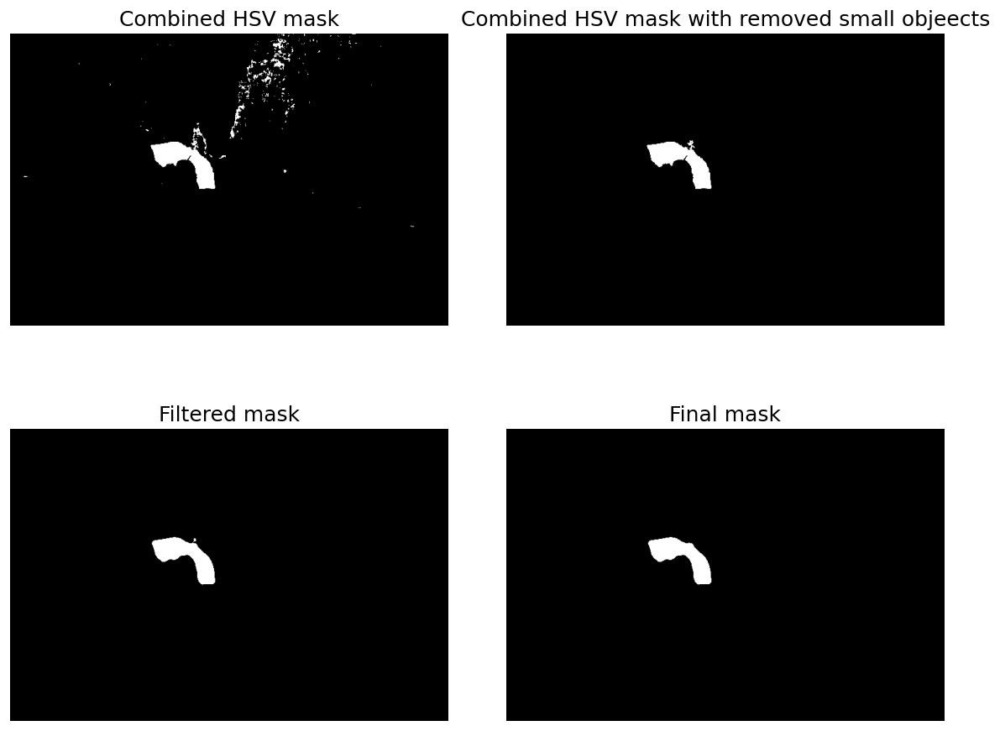

In [40]:
# Iscrtavanje prethodno dobijenih maski
fig, axes = subplots(ncols = 2, nrows = 2, figsize = (10, 8), dpi = 120)
ax = axes.ravel();
plt.tight_layout()
ax[0].imshow(combined_hsv_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[0].set_title('Combined HSV mask', fontsize = 15); 
ax[0].axis('off');

ax[1].imshow(combined_hsv_mask_removed, cmap = 'gray', vmin = 0, vmax = 1); 
ax[1].set_title('Combined HSV mask with removed small objeects', fontsize = 15); 
ax[1].axis('off');

ax[2].imshow(median_filtered_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[2].set_title('Filtered mask', fontsize = 15); 
ax[2].axis('off');

ax[3].imshow(final_mask, cmap = 'gray', vmin = 0, vmax = 1); 
ax[3].set_title('Final mask', fontsize = 15); 
ax[3].axis('off');
plt.show()

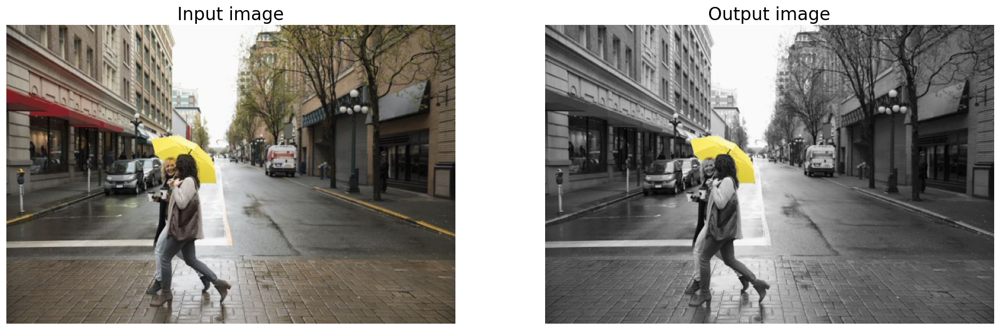

In [41]:
# Formiranje izlazni slike
umbrella_rgb = zeros((shape(street_rgb)), dtype = 'uint8')
no_umbrella_rgb = zeros((shape(street_rgb)), dtype = 'uint8')
for i in range (3):
    umbrella_rgb[:,:,i] = street_rgb[:,:,i]*final_mask
    no_umbrella_rgb[:,:,i] = street_rgb[:,:,i]*(~final_mask)

street_gray_no_umbrella = uint8(mean(no_umbrella_rgb, 2))
street_rgb_no_umbrella = gray2rgb(street_gray_no_umbrella)
street_only_umbrella = street_rgb_no_umbrella + umbrella_rgb

# Iscrtavanje pocetne slike i izlazne slike
fig, axes = subplots(ncols = 2, nrows = 1, figsize = (20, 20), dpi = 120)
ax = axes.ravel();

ax[0].imshow(street_rgb); 
ax[0].set_title('Input image', fontsize = 20); 
ax[0].axis('off');

ax[1].imshow(street_only_umbrella); 
ax[1].set_title('Output image', fontsize = 20); 
ax[1].axis('off');

###### Koriscen je HSV kolor sistem u kombinaciji sa RGB kolor sistemom. Maske se dobijaju kombinacijom H, S, V i G komponente HSV kolor sistema i RGB kolor sistema, respektivno. Pragovi za binarizaiju maski su dobijeni eksperimentalno. Sve maske su prethodno isprocesirane sa median filtrima i filtrima iz skimage.morphology paketa kako bi se dobio validan izgled maske. Morfoloska operacija dilatacija, koriscena pri dobijanju maski, funkcionise tako sto na prethodno definisanom prozoru binarne slike u slucaju barem jedne vrednosti piksela 1, postavlja vrednost piksela (oko koga je centriran prozor) na 1.~

# Treci zadatak

#### Funkcija bilateral_filter

In [42]:
def bilateral_filter(x, radius, sigma_s, sigma_r):
    
    # Dimenzije ulazne slike
    M = shape(x)[0]
    N = shape(x)[1]
    
    # konvertovanje u float
    image_type = type(x[0,0])
    if image_type == uint8:
        x = img_as_float(x)
        
    # Provera tipa slike
    if (image_type != uint8 and image_type != double):
        print('GRESKA ! Slika koja je prosledjena nije odgovarajuceg tipa!')
        return False
    # Provera opsega vrednosti intenziteta piksela tipa uint8
    if (image_type == uint8 and x.max() > 255 and x.min() < 0):
        print('GRESKA ! Slika koja je prosledjena ima vrednosti izvan opsega!')
        return False
    # Provera opsega vrednosti intenziteta piksela tipa double
    if (image_type == double and x.max() > 1 and x.min() < 0):
        print('GRESKA ! Slika koja je prosledjena ima vrednosti izvan opsega!')
        return False
    # Provera opsega vrednosti parametra sigma_r
    if (sigma_r > 1 or sigma_r < 0):
        print('GRESKA ! Parametar sigma_r se ne nalazi u dozvoljenom opsegu vrednosti!')
        return False
    
    # kreiranje Gausovog fitra
    gauss_filter = [[(k**2 + l**2) for l in range(-radius, radius+1)] for k in range(-radius, radius+1)]
    gauss_filter = np.array(gauss_filter)
    gauss_filter = np.exp(-gauss_filter/(2*sigma_s**2))
    
    # sirenje slike 
    height = shape(x)[0] + 2*radius
    width = shape(x)[1] + 2*radius
    
    # Alociranje memorije za prosirenu sliku
    new_x = np.zeros((height, width))
    new_x[radius:(height-radius), radius:(width-radius)] = x  # kopiranje neprosirene slike u sredinu nove slike 
    
    for i in range(radius):
        # popunjavanje dela direktno iznad originalne slike
        new_x[i,radius:(width-radius)] = x[0,:]
        # popunjavanje dela levo od originalne slike
        new_x[radius:(height-radius), i] = x[:,0]
        # popunjavanje dela desno od originalne slike
        new_x[radius:(height-radius), (width - 1 - i)] = x[:,(N-1)]
        # popunjavanje dela direktno ispod originalne slike
        new_x[height - 1 - i,radius:(width-radius)] = x[M-1,:]
    
    new_x[0:radius, 0:radius] = x[0,0] # popunjavanje gornjeg levog coska
    new_x[0:radius, (width-radius):width] = x[0,N-1] # popunjavanje gornjeg desnog coska
    new_x[(height-radius):height, 0:radius] = x[M-1,0] # popunjavanje donjeg levog coska
    new_x[(height-radius):height, (width-radius):width] = x[M-1,N-1] # popunjavanje donjeg desnog coska
    
    out_x = np.zeros_like(x)
    
    # glavna petlja za filtriranje slike
    for i in range(M):
        for j in range(N):
            # izdvajanje prozora na kome se izvrsava konvolucija
            window = new_x[i:(i+2*radius+1), j:(j+2*radius+1)]
            
            # racunanje razlike izmedju piksela
            w = window - x[i,j]
            
            # dizanje na eksponent i deljenje sa sigma
            w = np.exp(-w**2/(2*sigma_r**2))
            
            # mnozenje sa gausovim filtrom
            weighted_window = w*gauss_filter
            
            # normlizacija koeficijenata
            weighted_window = weighted_window/weighted_window.sum()
            
            # Sumiranje dobijenih vrednosti i smestanje u piskel izlazne slike
            out_x[i,j] = (weighted_window*window).sum()
    
    
    if image_type == uint8: # vracanja slike na njen pravi tip vrednosti
        out_x = uint8(255*out_x)
            
    return out_x

IMPLEMENTIRANA FUNCKIJA:
Vreme izvrsavanja: 0.774s 

Vreme izvrsavanja: 773735.046 us/pix 



UGRADJENA FUNCKIJA:
Vreme izvrsavanja: 0.021s 

Vreme izvrsavanja: 20913.839 us/pix 

IMPLEMENTIRANA FUNCKIJA:
Vreme izvrsavanja: 0.844s 

Vreme izvrsavanja: 844004.631 us/pix 



UGRADJENA FUNCKIJA:
Vreme izvrsavanja: 0.044s 

Vreme izvrsavanja: 43863.297 us/pix 

IMPLEMENTIRANA FUNCKIJA:
Vreme izvrsavanja: 1.99s 

Vreme izvrsavanja: 1989778.757 us/pix 



UGRADJENA FUNCKIJA:
Vreme izvrsavanja: 0.785s 

Vreme izvrsavanja: 785308.599 us/pix 

IMPLEMENTIRANA FUNCKIJA:
Vreme izvrsavanja: 4.825s 

Vreme izvrsavanja: 4824609.756 us/pix 



UGRADJENA FUNCKIJA:
Vreme izvrsavanja: 3.022s 

Vreme izvrsavanja: 3022055.149 us/pix 

IMPLEMENTIRANA FUNCKIJA:
Vreme izvrsavanja: 6.774s 

Vreme izvrsavanja: 6774105.31 us/pix 



UGRADJENA FUNCKIJA:
Vreme izvrsavanja: 4.614s 

Vreme izvrsavanja: 4613880.157 us/pix 



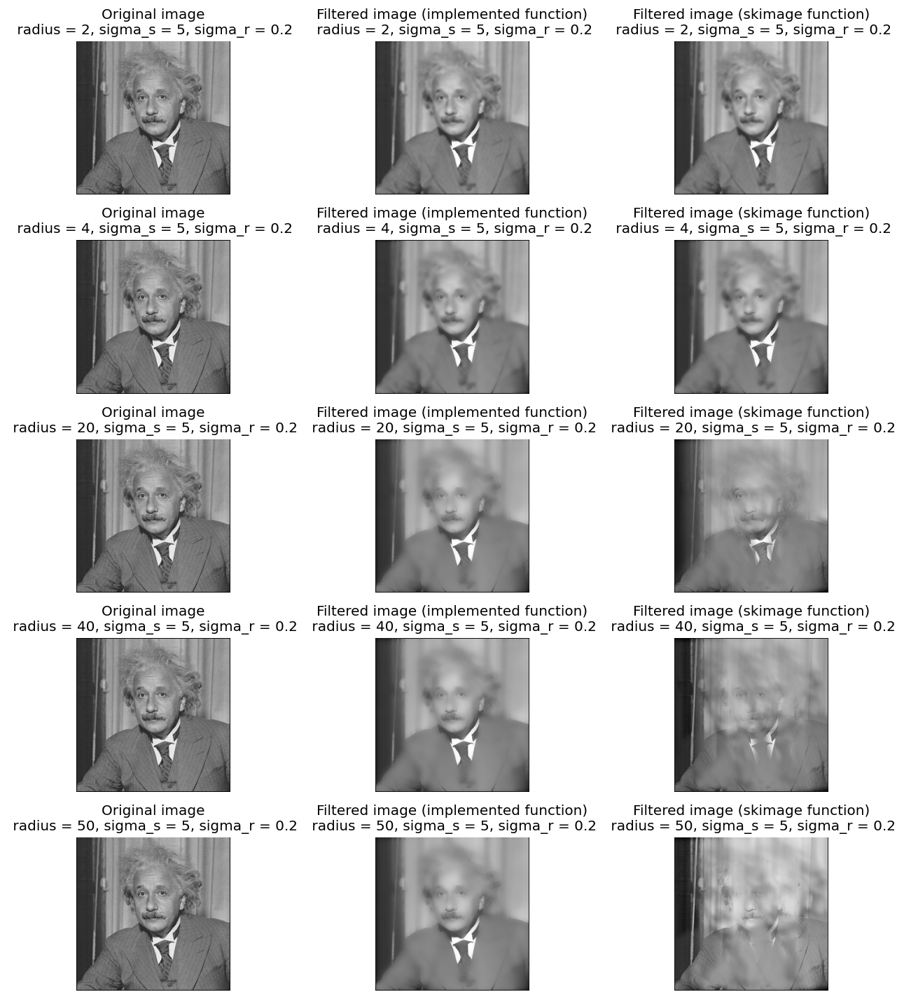

In [43]:
image_name = 'einstein.tif'
x = imread(image_name) # Ucitavanje slike
x = img_as_float(x) # Konverzija u float zbog ugradjene funkcije 

radius_arr = [2,4,20, 40, 50] # niz za radius-e
sigma_s = 5 # standardna devijacija za Gausov filtar
sigma_r = 0.2 # standardna devijacija za filtar po intenziteta piksela
sigma_spatial = sigma_s # standardna devijacija za Gausov filtar za ugradjenu funkciju
sigma_color = sigma_r # standardna devijacija za filtar po intenziteta piksela za ugradjenu funkciju

fig, ax = plt.subplots(nrows=5, ncols=3, figsize=(12,12), dpi=120)

for i in range(5):
    # Parametri implementirane funkcije
    radius = radius_arr[i]

    # Ekvivalentni parametri ugradjene funkcije
    win_size = 2*radius + 1

    start = time.time()
    # Pozivanje implementirane funkcije
    out_x = bilateral_filter(x, radius, sigma_s, sigma_r)

    if out_x.any() != False:
        end = time.time()
        execution_time = (end - start)
        print('IMPLEMENTIRANA FUNCKIJA:')
        print('Vreme izvrsavanja: ' + str(round(execution_time,3))+ 's \n')
        execution_time_norm = execution_time/np.size(out_x)
        print('Vreme izvrsavanja: ' + str(round(execution_time*1e6,3))+ ' us/pix \n')

        start = time.time()
        # Pozivanje ugradjene funkcije
        out_x_ugradjena = skimage.restoration.denoise_bilateral(image=x, win_size=win_size, sigma_spatial=sigma_spatial, sigma_color=sigma_color)
        end = time.time()
        execution_time = (end - start)
        print('\n\nUGRADJENA FUNCKIJA:')
        print('Vreme izvrsavanja: ' + str(round(execution_time,3))+ 's \n')
        execution_time_norm = execution_time/np.size(out_x_ugradjena)
        print('Vreme izvrsavanja: ' + str(round(execution_time*1e6,3))+ ' us/pix \n')

        ax[i,0].imshow(x, cmap='gray')
        ax[i,0].set_title('Original image\n radius = ' + str(radius) + ', sigma_s = ' + str(sigma_s) + ', sigma_r = ' + str(sigma_r))
        ax[i,0].set_axis_off()

        ax[i,1].imshow(out_x, cmap='gray')
        ax[i,1].set_title('Filtered image (implemented function)\n radius = ' + str(radius) + ', sigma_s = ' + str(sigma_s) + ', sigma_r = ' + str(sigma_r))
        ax[i,1].set_axis_off()

        ax[i,2].imshow(out_x_ugradjena, cmap='gray')
        ax[i,2].set_title('Filtered image (skimage function)\n radius = ' + str(radius) + ', sigma_s = ' + str(sigma_s) + ', sigma_r = ' + str(sigma_r))
        ax[i,2].set_axis_off()

plt.tight_layout()
plt.show()

###### Povecavanjem radiusa, zamucenje Gaussovim filtrom je izrazenije dok ivice ostaju istaknute. Za malo prostorno sigma ugradjena funkcija ima dosta lose rezultate (u vidu dupliranja i pojavlljivanja nepostojecih ivica), dok se na slici dobijenoj implementiranom funkcjom moze uociti zamucenje teksture na sakou i kravati, dok ivice ostaju ostre. Slika dobijena ugradjenom funkcijom je znacajno deformisana za vece radiuse.